<a href="https://colab.research.google.com/github/FreNzQuiN/Blogger-theme/blob/main/Stable_Diffusion/MyLatestInlineSD.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1.1 START -- TEXT2IMG SD**

In [1]:
!pip install -q diffusers transformers accelerate safetensors compel huggingface_hub[hf_xet] torchsde # --upgrade
import torch
from torch import autocast
from diffusers import StableDiffusionXLPipeline
from compel import Compel, ReturnedEmbeddingsType
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter
import random, time, math, os
import torch, gc
from tqdm import tqdm
import requests
from io import BytesIO

JUSTSTART = True #@param {type:"boolean"}

if not os.path.exists("scheduler_config.json"):
  !wget https://huggingface.co/cagliostrolab/animagine-xl-4.0/resolve/main/scheduler/scheduler_config.json

custom_config = True #@param {type:'boolean'}
if os.path.exists("scheduler_config.json") and not custom_config:
  with open("scheduler_config.json", "r") as f:
    scheduler_config = json.load(f)
else:
  scheduler_config = {
    "beta_start": 0.00085,
    "beta_end": 0.012,
    "num_train_timesteps": 1000,
    "steps_offset" : 2,
    "beta_schedule": "scaled_linear",
    "clip_sample": False,
    "set_alpha_to_one": False,
    "_class_name": "DDIMScheduler",
    "_diffusers_version": "0.32.2"
  }

#@markdown ## **Scheduler**
SCHEDULER = "DDIMScheduler" # @param ["DDIMScheduler","EulerAncestralDiscreteScheduler","DPMSolverSDEScheduler","KDPM2AncestralDiscreteScheduler","PNDMScheduler","DPMPlusPlus2SAntesralDiscreteScheduler"]

if JUSTSTART:
  pipe = StableDiffusionXLPipeline.from_pretrained(
      "cagliostrolab/animagine-xl-4.0",
      torch_dtype=torch.float16,
      use_safetensors=True,
      custom_pipeline="lpw_stable_diffusion_xl",
      add_watermarker=False,
      )

if SCHEDULER == "EulerAncestralDiscreteScheduler":
  from diffusers import EulerAncestralDiscreteScheduler
  pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(scheduler_config)
elif SCHEDULER == "DDIMScheduler":
  from diffusers import DDIMScheduler
  pipe.scheduler = DDIMScheduler.from_config(scheduler_config)
elif SCHEDULER == "DPMSolverSDEScheduler":
    from diffusers import DPMSolverSDEScheduler
    pipe.scheduler = DPMSolverSDEScheduler.from_config(scheduler_config, use_karras_sigmas=True)
elif SCHEDULER == "KDPM2AncestralDiscreteScheduler":
    from diffusers import KDPM2AncestralDiscreteScheduler
    pipe.scheduler = KDPM2AncestralDiscreteScheduler.from_config(scheduler_config)
elif SCHEDULER == "PNDMScheduler":
    from diffusers import PNDMScheduler
    pipe.scheduler = PNDMScheduler.from_config(scheduler_config)
elif SCHEDULER == "DPM++ 2S AncestralDiscreteScheduler":
    from diffusers import DPMPlusPlus2SAntesralDiscreteScheduler
    pipe.scheduler = DPMPlusPlus2SAntesralDiscreteScheduler.from_config(scheduler_config, use_karras_sigmas=True) # Often benefits from Karras


pipe.to('cuda')

!curl -o wd14-tagger.py https://raw.githubusercontent.com/FreNzQuiN/GenerativeAI/refs/heads/main/Stable_Diffusion/wd14-tagger.py

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.2/61.2 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.6/53.6 MB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 48.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 47.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 20.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 62.4 MB/s eta 0:00:00
--2025-05-10 22:15:59--  https://huggingface.co

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/671 [00:00<?, ?B/s]

lpw_stable_diffusion_xl.py:   0%|          | 0.00/107k [00:00<?, ?B/s]

Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/560 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/613 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/704 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/855 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.77k [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/782 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  7937  100  7937    0     0  33409      0 --:--:-- --:--:-- --:--:-- 33489


In [17]:
!pip install torchsde

In [ ]:
# download model
!wget https://github.com/xinntao/Real-ESRGAN/releases/download/v0.2.2.4/RealESRGAN_x4plus_anime_6B.pth -P weights
!curl inference_realesrgan.py -o https://raw.githubusercontent.com/xinntao/Real-ESRGAN/refs/heads/master/inference_realesrgan.py
# inference
!python inference_realesrgan.py -n RealESRGAN_x4plus_anime_6B -i inputs

In [ ]:
#@title #**1.2 START -- IMG2IMG SD**
!pip install diffusers transformers accelerate safetensors compel --upgrade
import torch
from torch import autocast
from diffusers import StableDiffusionXLPipeline, DDIMScheduler
from compel import Compel, ReturnedEmbeddingsType
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter
import random, time, math, os
import torch, gc
from tqdm import tqdm
import json
import requests
from io import BytesIO

if not os.path.exists("scheduler_config.json"):
    !wget https://huggingface.co/cagliostrolab/animagine-xl-4.0/resolve/main/scheduler/scheduler_config.json

custom_config = True  # @param {type:'boolean'}
if os.path.exists("scheduler_config.json") and not custom_config:
    with open("scheduler_config.json", "r") as f:
        scheduler_config = json.load(f)
else:
    scheduler_config = {
        "beta_start": 0.00085,
        "beta_end": 0.012,
        "num_train_timesteps": 1000,
        "steps_offset": 2,
        "beta_schedule": "scaled_linear",
        "clip_sample": False,
        "set_alpha_to_one": False,
        "_class_name": "DDIMScheduler",
        "_diffusers_version": "0.32.2"
    }

pipe = StableDiffusionXLPipeline.from_pretrained(
    "cagliostrolab/animagine-xl-4.0",
    torch_dtype=torch.float16,
    use_safetensors=True,
    custom_pipeline="lpw_stable_diffusion_xl",
    add_watermarker=False,
)

pipe.scheduler = DDIMScheduler.from_config(scheduler_config)
pipe.to('cuda')

In [2]:
#@title #**2.1 PLAY TEXT2IMG SD**

num=0
prompt_num=1
def disabled_safety_checker(images, clip_input):
    if len(images.shape)==4:
        num_images = images.shape[0]
        return images, [False]*num_images
    else:
        return images, False
pipe.safety_checker = disabled_safety_checker

Generating Images 23:   0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/28 [00:00<?, ?it/s]

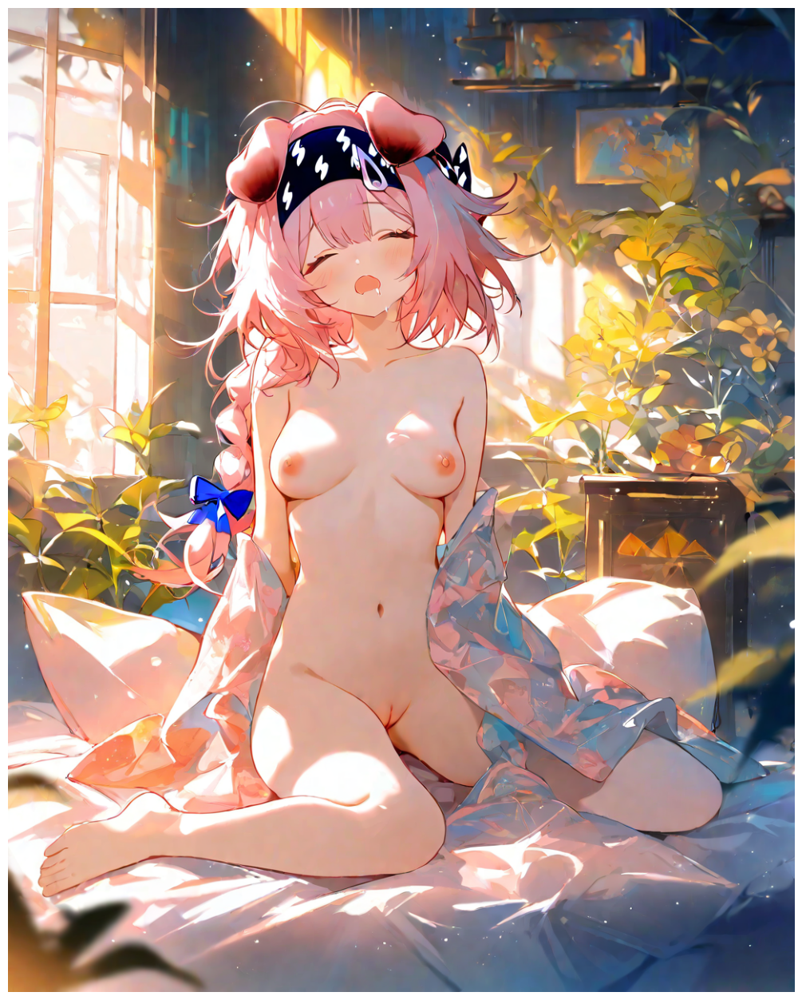

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_23_7936332_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, solo, animal_ears, nipples, pink_hair, cat_ears, navel, closed_eyes, sitting, pussy, barefoot, nude, open_mouth, long_hair, braid, bow, hair_bow, wariza, hairband, blue_bow, plant, drooling, indoors, completely_nude, black_hairband, medium_breasts, blush, open_clothes, lightning_bolt_print, stomach, floppy_ears, cat_girl, collarbone, sunlight, uncensored, full_body, toes, facing_viewer, saliva, window, small_breasts, pillow, single_braid, on_bed, feet, flower, day, potted_plant, cleft_of_venus, off_shoulder, bed_sheet, floral_print, sleeping, cum, cat_tail, toenails, morning, shirt, bed, open_shirt, goldenglow_(arknights)
--------
Tags: 1girl, breasts, s

Generating Images 23:   4%|▍         | 1/25 [00:44<17:54, 44.79s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

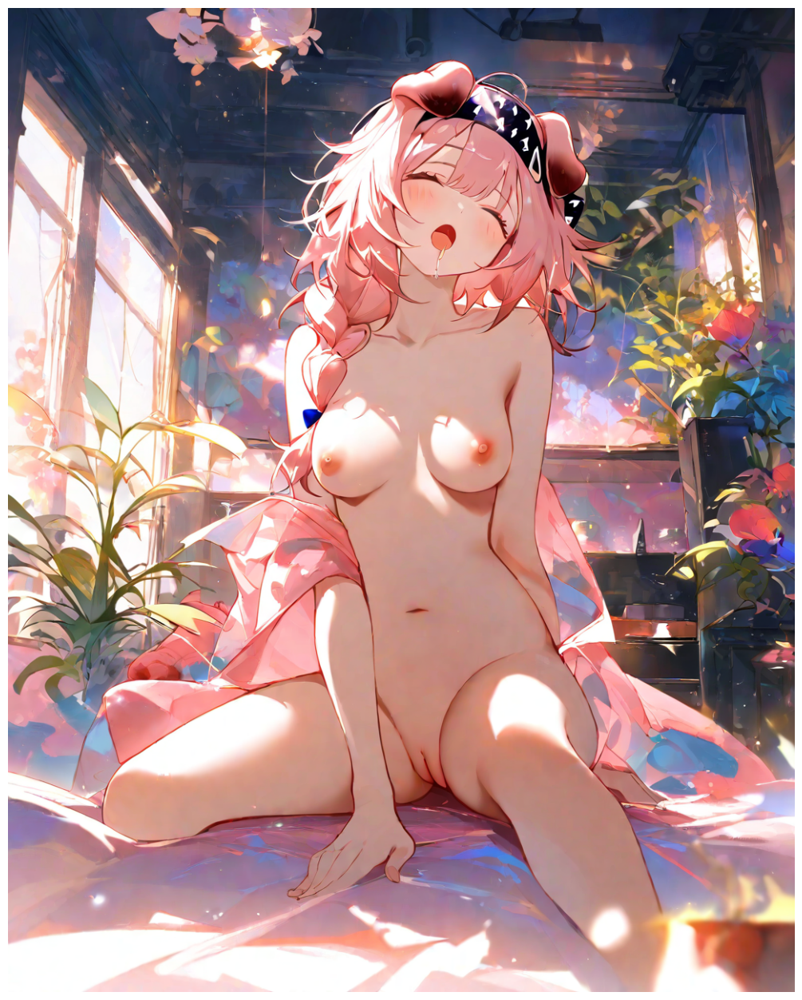

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_24_307321_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, nipples, solo, animal_ears, pink_hair, open_mouth, pussy, cat_ears, closed_eyes, nude, lightning_bolt_print, navel, braid, sitting, hairband, indoors, long_hair, medium_breasts, blush, completely_nude, plant, black_hairband, collarbone, uncensored, stomach, window, pink_jacket, hair_bow, cat_girl, bow, potted_plant, floppy_ears, blue_bow, sunlight, open_clothes, feet_out_of_frame, single_braid, facing_viewer, flower, on_bed, head_tilt, day, spread_legs, drooling, ahoge, yawning, hanging_plant, saliva, between_legs, hair_over_shoulder, off_shoulder, side_braid, cleft_of_venus, thighs, hand_between_legs, bed_sheet, censored, arm_support, ass_visible_through

Generating Images 23:   8%|▊         | 2/25 [01:30<17:25, 45.47s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

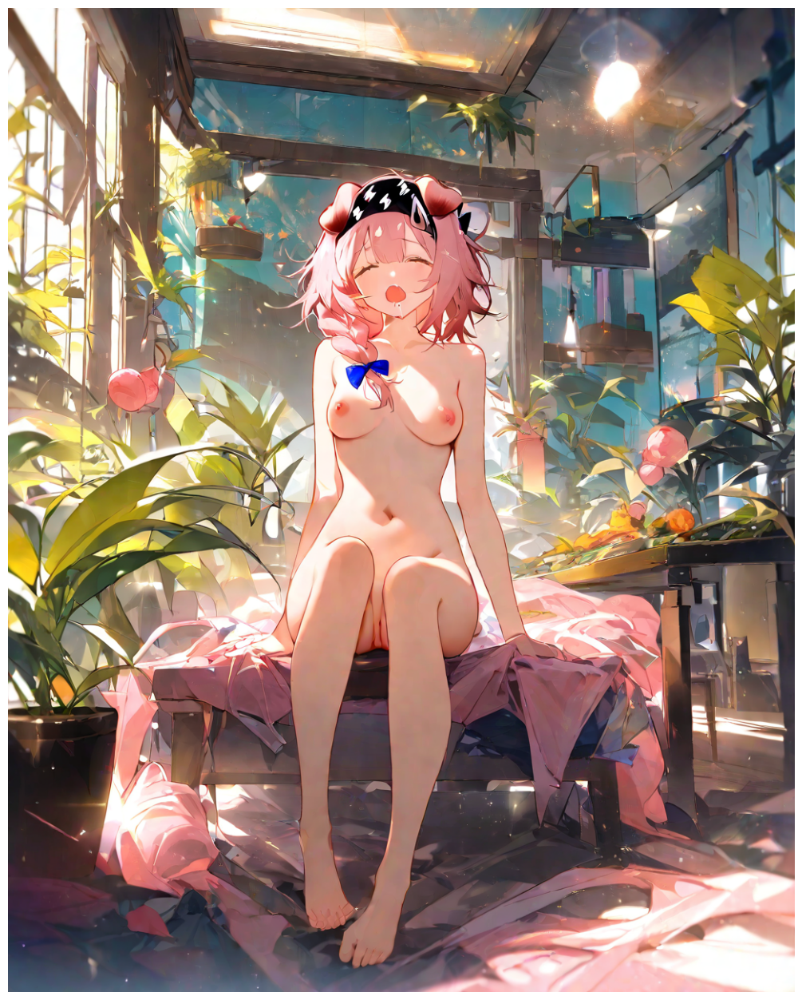

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_25_2049005_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, animal_ears, nude, solo, nipples, completely_nude, pink_hair, closed_eyes, cat_ears, open_mouth, navel, sitting, barefoot, pussy, plant, braid, blue_bow, indoors, hairband, bow, hair_bow, potted_plant, facing_viewer, black_hairband, full_body, toes, lightning_bolt_print, medium_breasts, long_hair, feet, cat_girl, fruit, stomach, single_braid, hanging_plant, collarbone, blush, toenails, pink_jacket, food, uncensored, side_braid, cat_tail, censored, floppy_ears, legs, window, sunlight, yawning, day, mosaic_censoring, hair_ornament, hair_over_shoulder, goldenglow_(arknights)
--------
Tags: 1girl, breasts, animal ears, nude, solo, nipples, completely nude, p

Generating Images 23:  12%|█▏        | 3/25 [02:17<16:50, 45.91s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

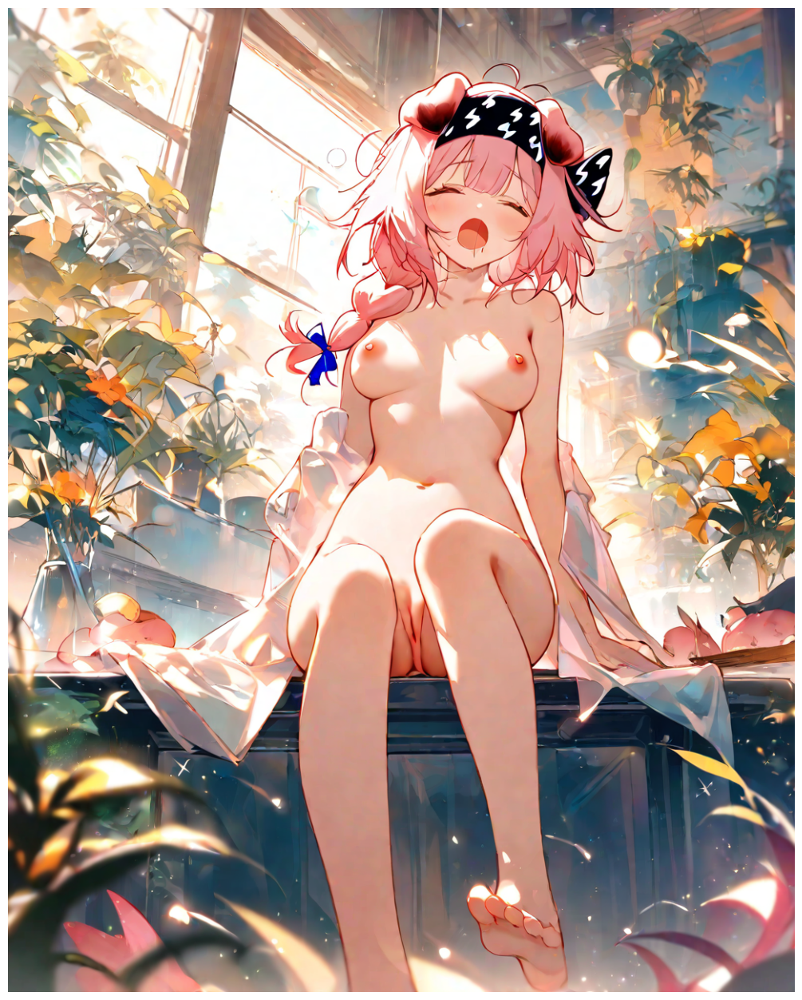

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_26_127515_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, solo, animal_ears, pink_hair, nipples, nude, open_mouth, cat_ears, pussy, closed_eyes, navel, sitting, barefoot, completely_nude, braid, feet, plant, toes, long_hair, hairband, medium_breasts, indoors, soles, black_hairband, collarbone, bow, blush, cat_girl, hair_bow, blue_bow, potted_plant, single_braid, flower, window, censored, stomach, lightning_bolt_print, floppy_ears, uncensored, drooling, yawning, open_clothes, saliva, facing_viewer, shirt, white_shirt, sunlight, mosaic_censoring, day, legs, foot_out_of_frame, arm_support, ahoge, breasts_apart, hanging_plant, side_braid, fruit, food, open_shirt, cat_tail, foreshortening, feet_out_of_frame, goldengl

Generating Images 23:  16%|█▌        | 4/25 [03:02<16:00, 45.76s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

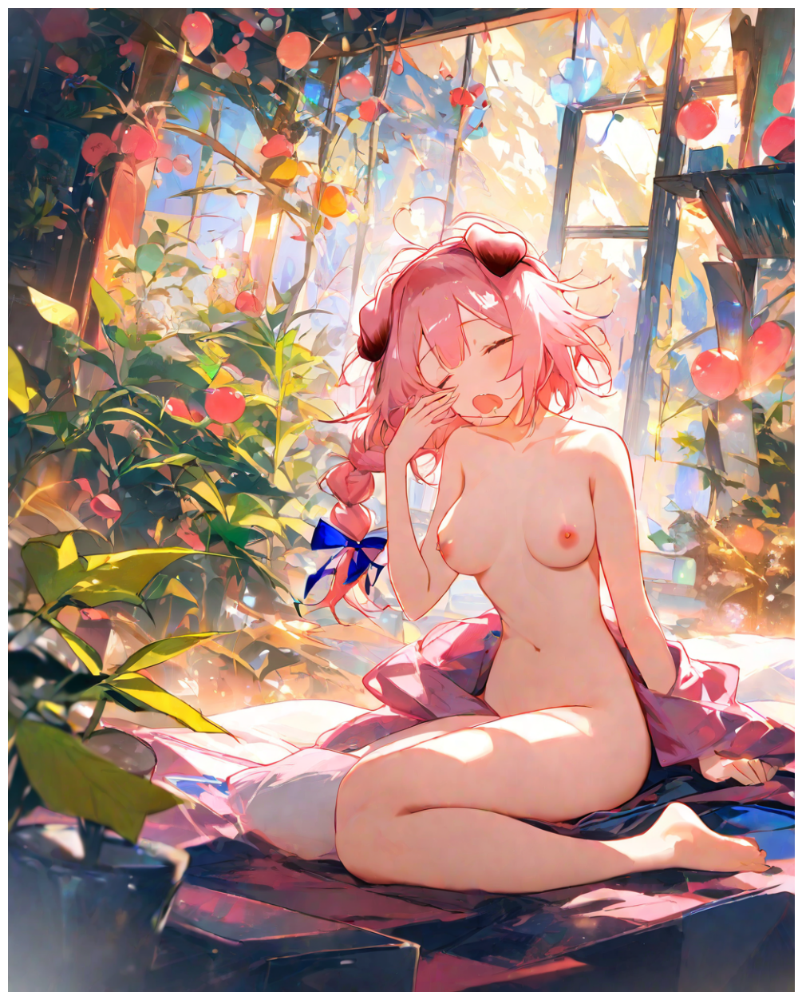

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_27_3695582_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, nipples, solo, animal_ears, pink_hair, nude, yawning, open_mouth, sitting, barefoot, navel, closed_eyes, braid, plant, long_hair, medium_breasts, cat_ears, bow, blue_bow, completely_nude, hair_bow, ahoge, potted_plant, collarbone, indoors, single_braid, window, full_body, heart, wariza, floppy_ears, hanging_plant, blush, day, fruit, stomach, cat_girl, drooling, sunlight, hand_up, facing_viewer, thighhighs, heart_ahoge, bed_sheet, white_thighhighs, flower, saliva, waking_up, pink_jacket, toes, on_bed, feet, tears, goldenglow_(arknights)
--------
Tags: 1girl, breasts, nipples, solo, animal ears, pink hair, nude, yawning, open mouth, sitting, barefoot, nave

Generating Images 23:  20%|██        | 5/25 [03:50<15:32, 46.62s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

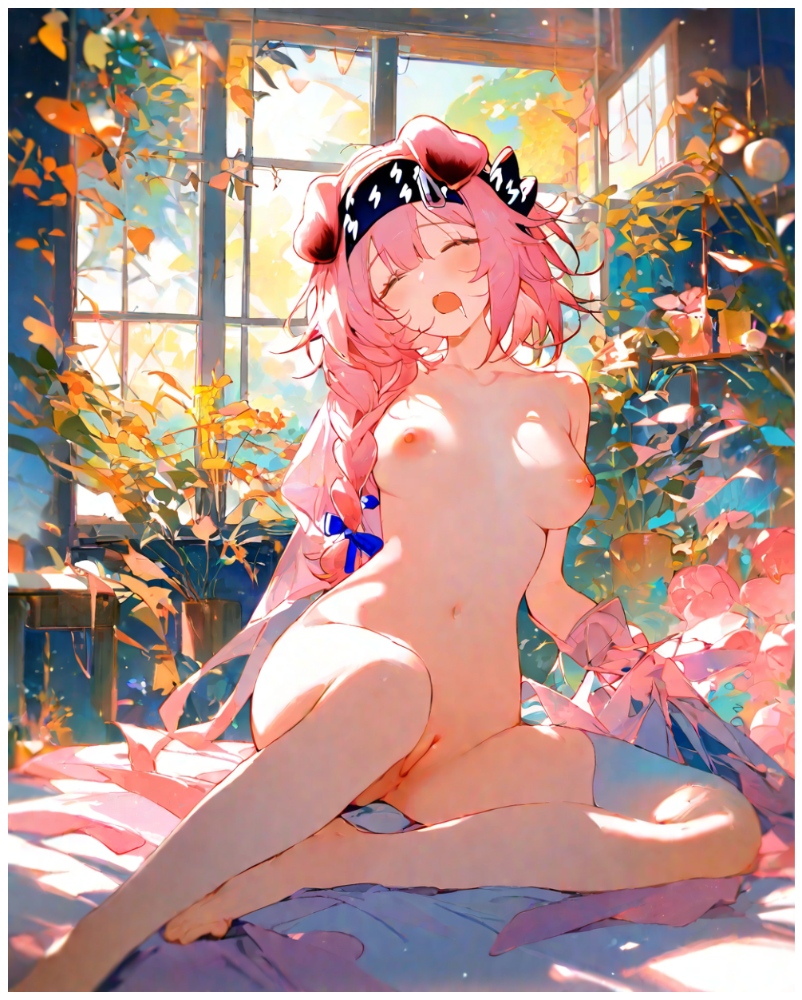

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_28_9766833_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, nipples, solo, animal_ears, pink_hair, cat_ears, nude, pussy, open_mouth, closed_eyes, braid, navel, hairband, long_hair, hair_bow, bow, barefoot, sitting, blue_bow, lightning_bolt_print, cat_girl, uncensored, indoors, black_hairband, medium_breasts, thighhighs, plant, collarbone, completely_nude, blush, floppy_ears, white_thighhighs, window, facing_viewer, single_braid, stomach, pink_jacket, toes, potted_plant, cat_tail, feet, open_clothes, day, drooling, flower, side_braid, hanging_plant, breasts_apart, tail, small_breasts, sunlight, cleft_of_venus, head_tilt, knee_up, sleeping, bed_sheet, censored, on_bed, goldenglow_(arknights)
--------
Tags: 1girl, 

Generating Images 23:  24%|██▍       | 6/25 [04:38<14:49, 46.82s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

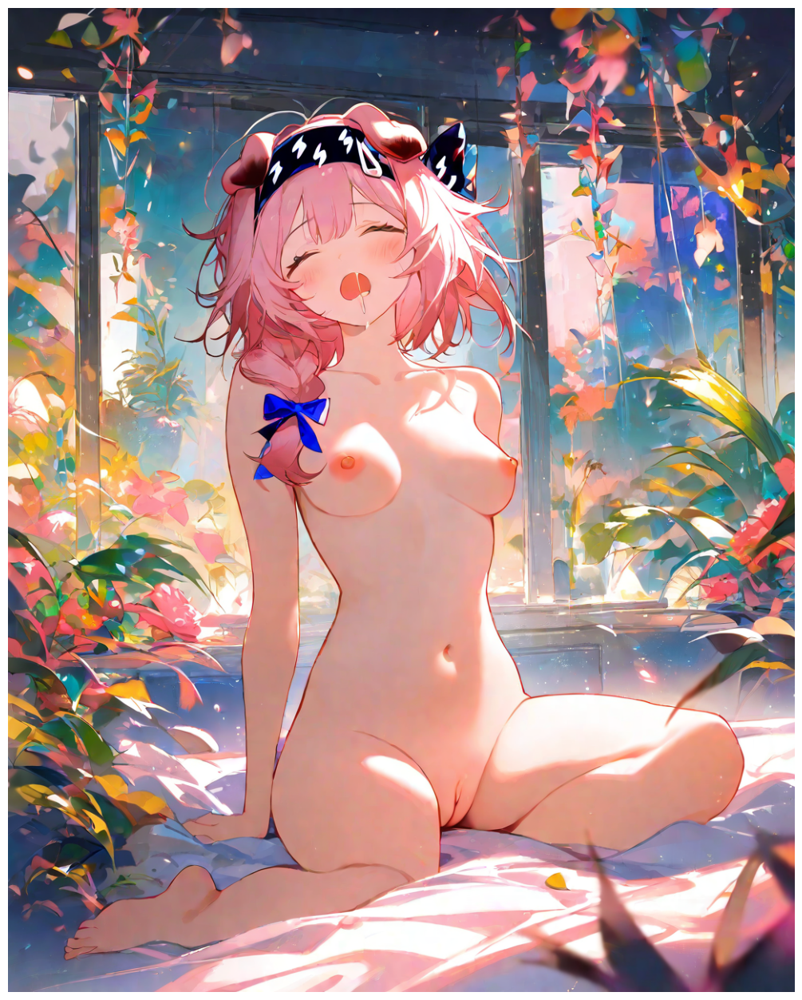

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_29_3779397_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, nipples, solo, nude, animal_ears, completely_nude, pink_hair, pussy, open_mouth, cat_ears, navel, closed_eyes, barefoot, sitting, hairband, braid, bow, hair_bow, blue_bow, blush, uncensored, lightning_bolt_print, collarbone, black_hairband, long_hair, drooling, stomach, single_braid, medium_breasts, toes, flower, full_body, plant, saliva, cat_girl, facing_viewer, feet, indoors, small_breasts, cleft_of_venus, arm_support, yokozuwari, window, side_braid, fang, on_bed, day, bed_sheet, floppy_ears, hair_over_shoulder, yawning, thighs, tears, goldenglow_(arknights)
--------
Tags: 1girl, breasts, nipples, solo, nude, animal ears, completely nude, pink hair, pu

Generating Images 23:  28%|██▊       | 7/25 [05:25<14:04, 46.90s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

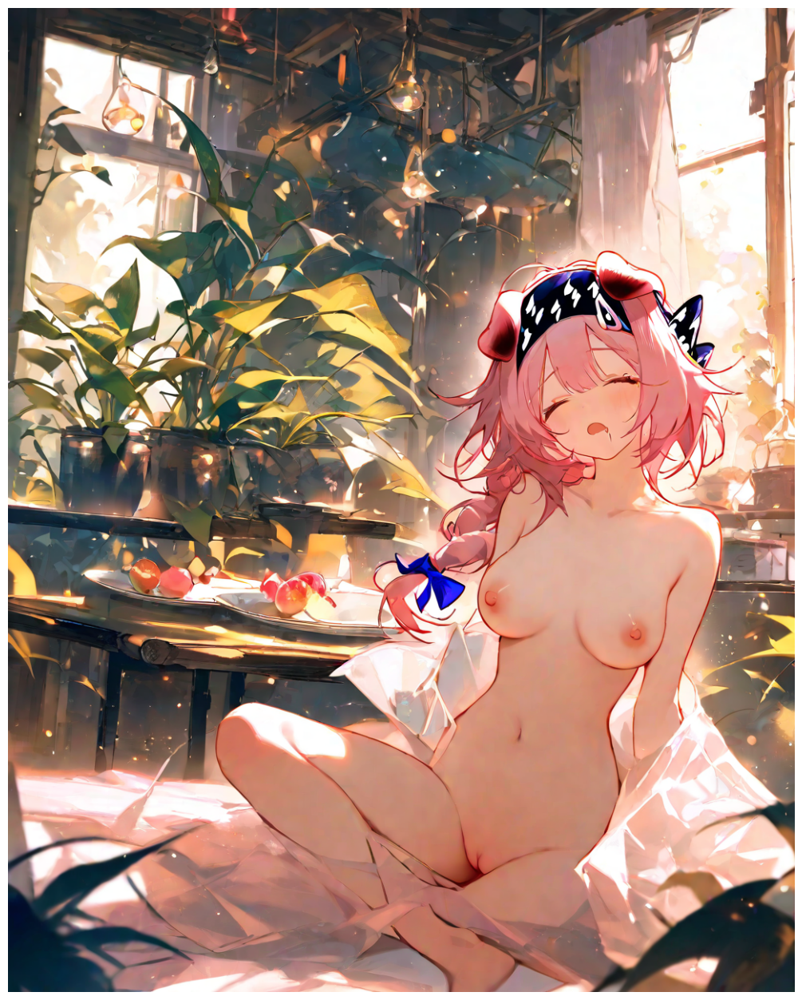

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_30_5846740_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, nipples, solo, animal_ears, pink_hair, cat_ears, nude, closed_eyes, pussy, long_hair, plant, fruit, braid, open_mouth, indoors, navel, sitting, bow, hair_bow, hairband, blue_bow, completely_nude, food, medium_breasts, lightning_bolt_print, window, facing_viewer, collarbone, potted_plant, barefoot, single_braid, blush, uncensored, cat_girl, stomach, black_hairband, floppy_ears, day, apple, open_clothes, plate, sunlight, hanging_plant, strawberry, curtains, large_breasts, table, drooling, breasts_apart, side_braid, crossed_legs, on_bed, head_tilt, indian_style, cat_tail, hair_between_eyes, full_body, light_particles, goldenglow_(arknights)
--------
Tags: 1

Generating Images 23:  32%|███▏      | 8/25 [06:12<13:18, 46.99s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

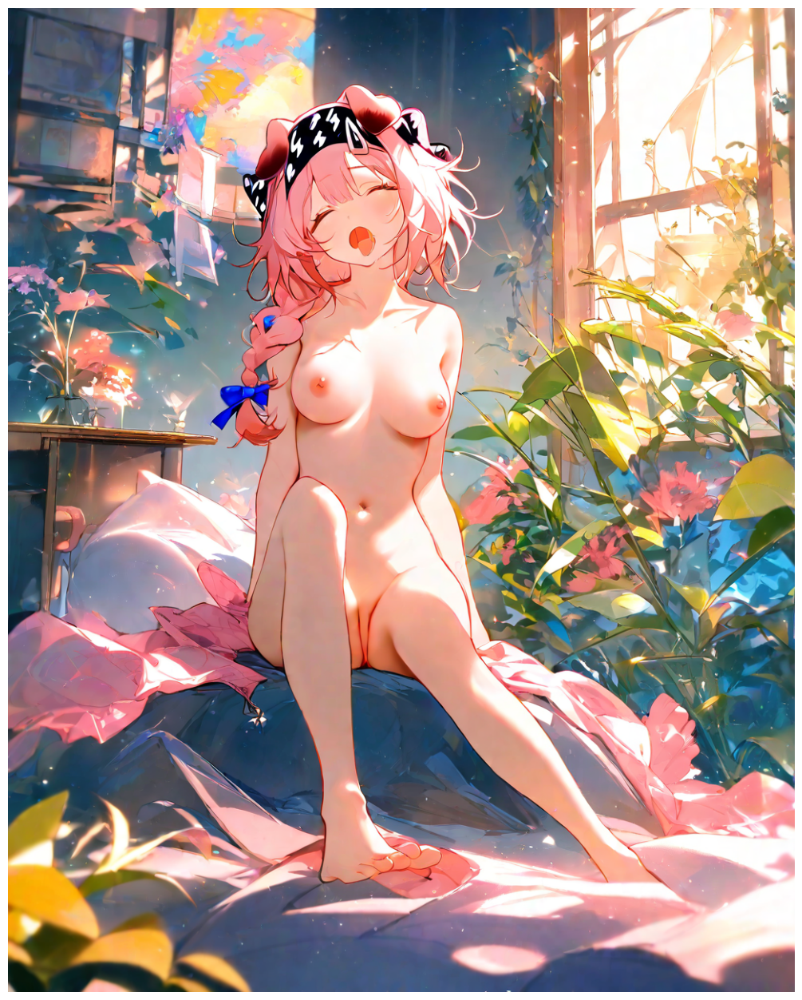

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_31_6057680_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, nipples, nude, solo, animal_ears, completely_nude, pink_hair, cat_ears, open_mouth, closed_eyes, navel, barefoot, sitting, braid, pussy, hairband, long_hair, indoors, bow, hair_bow, toes, plant, blue_bow, collarbone, lightning_bolt_print, feet, cat_girl, medium_breasts, window, flower, black_hairband, single_braid, stomach, blush, floppy_ears, cat_tail, potted_plant, on_bed, facing_viewer, knee_up, hanging_plant, yawning, tail, day, sunlight, pillow, soles, censored, legs, uncensored, toenails, bed_sheet, full_body, small_breasts, foot_out_of_frame, side_braid, pink_flower, mosaic_censoring, bed, drooling, :o, hair_over_shoulder, pink_jacket, goldenglow_

Generating Images 23:  36%|███▌      | 9/25 [07:00<12:36, 47.27s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

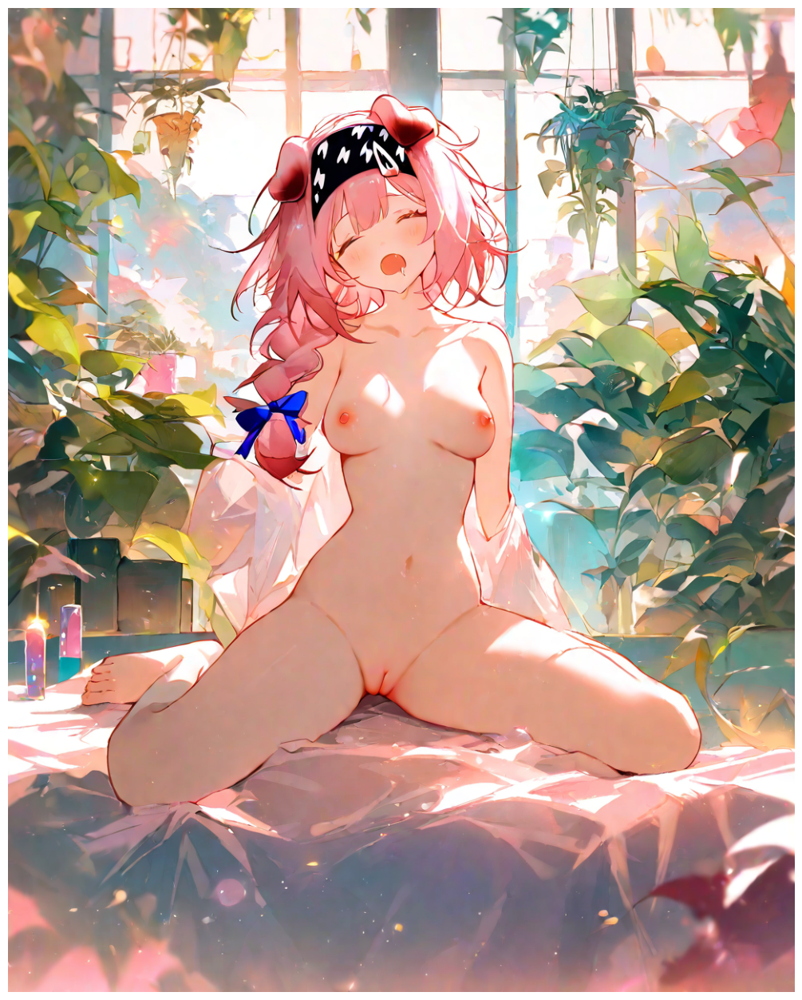

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_32_1072471_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, solo, nipples, animal_ears, pink_hair, pussy, open_mouth, cat_ears, closed_eyes, nude, navel, braid, barefoot, sitting, plant, long_hair, completely_nude, hair_bow, bow, blue_bow, hairband, wariza, medium_breasts, collarbone, uncensored, floppy_ears, indoors, blush, facing_viewer, stomach, cat_girl, full_body, single_braid, spread_legs, toes, shirt, potted_plant, window, black_hairband, open_clothes, white_shirt, candle, yawning, on_bed, feet, ass_visible_through_thighs, tears, open_shirt, bed_sheet, thighs, day, breasts_apart, off_shoulder, lightning_bolt_print, head_tilt, cleft_of_venus, naked_shirt, toenails, hair_over_shoulder, small_breasts, droolin

Generating Images 23:  40%|████      | 10/25 [07:47<11:50, 47.38s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

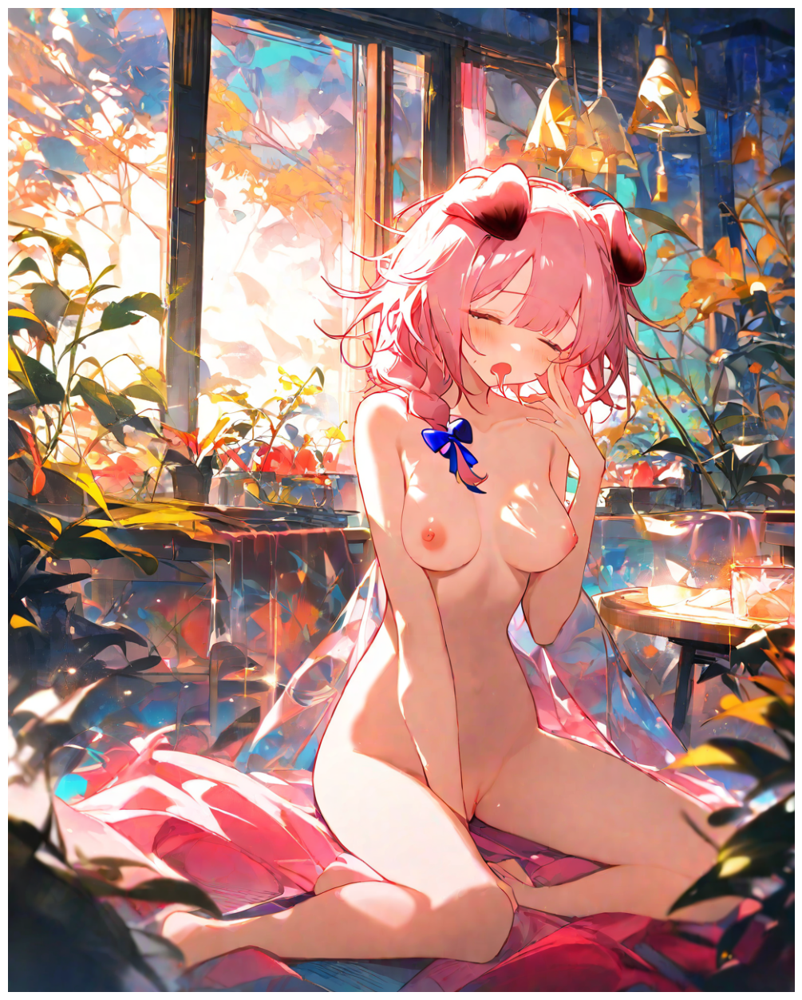

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_33_4543891_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, solo, animal_ears, nipples, pink_hair, nude, cat_ears, completely_nude, closed_eyes, open_mouth, sitting, blue_bow, braid, hair_bow, bow, yawning, plant, medium_breasts, blush, long_hair, barefoot, single_braid, indoors, floppy_ears, saliva, potted_plant, cat_girl, tongue, hanging_plant, navel, between_legs, collarbone, hand_between_legs, flower, facing_viewer, tongue_out, hand_up, full_body, drooling, pussy, table, window, cup, lightning_bolt_print, side_braid, hair_over_shoulder, day, wariza, fruit, tears, thighs, cat_tail, vase, stomach, blue_ribbon, yokozuwari, toes, goldenglow_(arknights)
--------
Tags: 1girl, breasts, solo, animal ears, nipples, pi

Generating Images 23:  44%|████▍     | 11/25 [08:35<11:04, 47.49s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

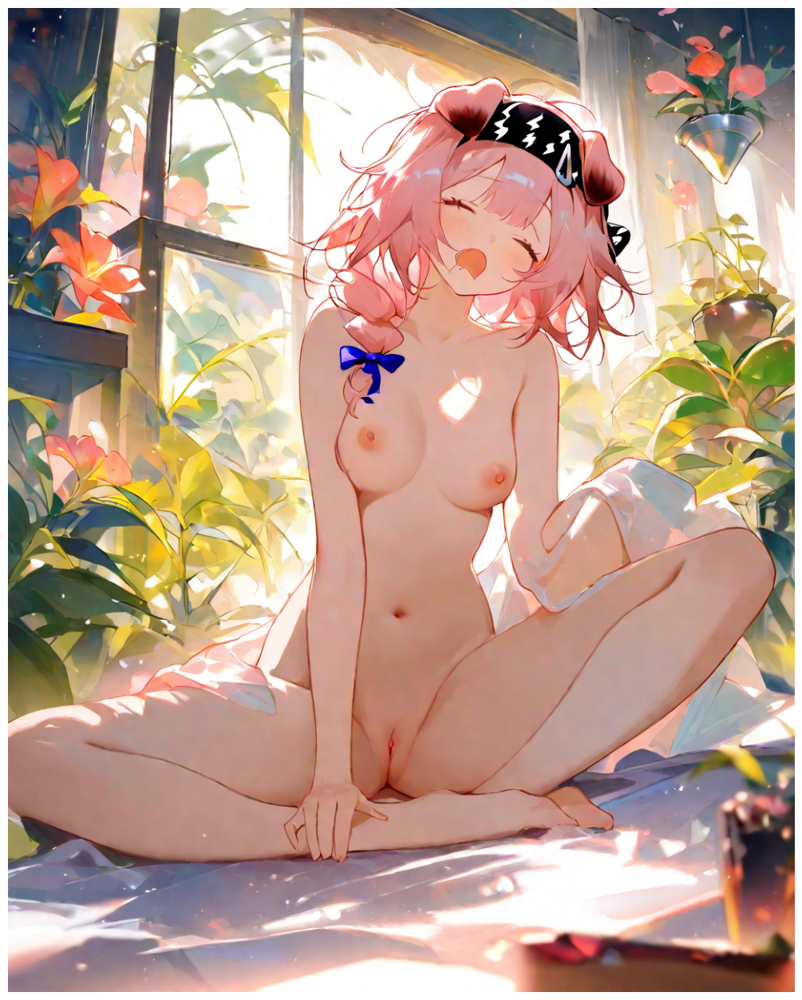

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_34_4601402_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, solo, nipples, animal_ears, pink_hair, nude, pussy, open_mouth, cat_ears, completely_nude, closed_eyes, navel, plant, sitting, barefoot, hairband, hair_bow, bow, braid, indoors, potted_plant, long_hair, medium_breasts, blue_bow, uncensored, flower, window, facing_viewer, yawning, black_hairband, stomach, blush, collarbone, spread_legs, single_braid, sunlight, hands_on_feet, full_body, day, floppy_ears, hanging_plant, cat_girl, indian_style, lightning_bolt_print, toes, feet, side_braid, on_bed, stretching, bed_sheet, censored, backlighting, red_flower, vase, pink_flower, small_breasts, head_tilt, hair_over_shoulder, goldenglow_(arknights)
--------
Tags: 1

Generating Images 23:  48%|████▊     | 12/25 [09:25<10:27, 48.25s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

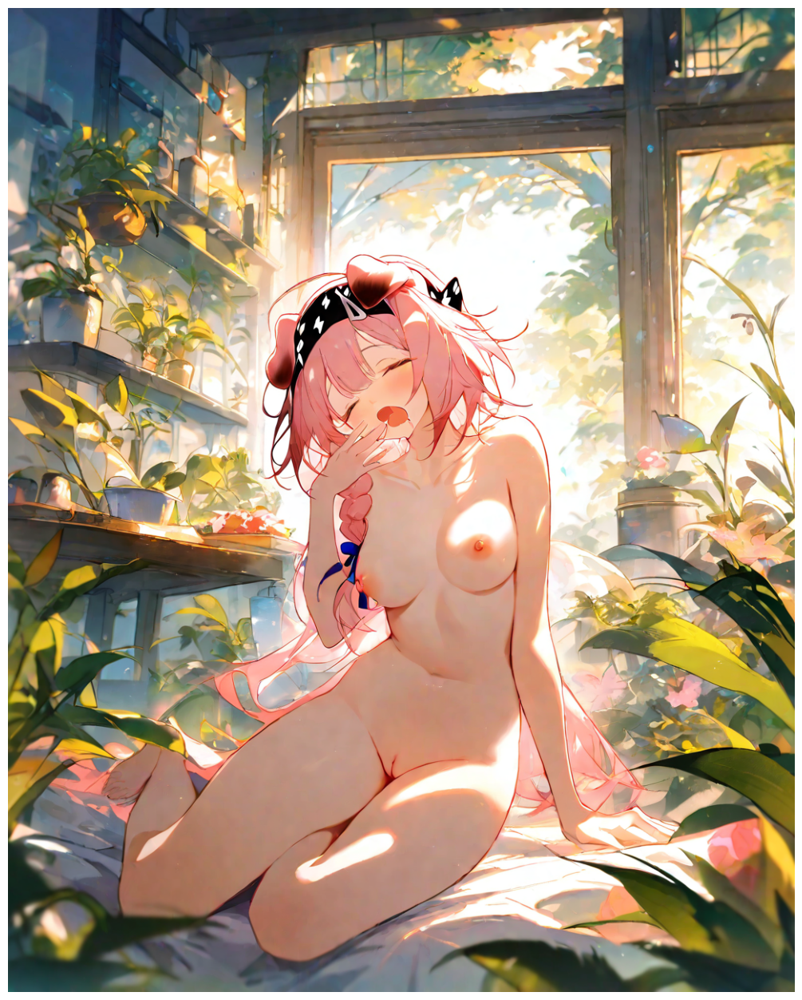

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_35_1745627_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, yawning, breasts, nipples, nude, solo, animal_ears, pink_hair, completely_nude, open_mouth, long_hair, cat_ears, pussy, plant, navel, sitting, closed_eyes, hairband, potted_plant, braid, black_hairband, hair_bow, bow, indoors, uncensored, barefoot, medium_breasts, collarbone, blue_bow, blush, full_body, cat_girl, lightning_bolt_print, arm_support, yokozuwari, sunlight, day, window, stomach, very_long_hair, single_braid, hanging_plant, facing_viewer, floppy_ears, side_braid, tears, cat_tail, hand_up, morning, flower, black_bow, fruit, cleft_of_venus, waking_up, thighs, drooling, on_bed, bed_sheet, saliva, breasts_apart, goldenglow_(arknights)
--------
Tags: 1girl,

Generating Images 23:  52%|█████▏    | 13/25 [10:15<09:45, 48.79s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

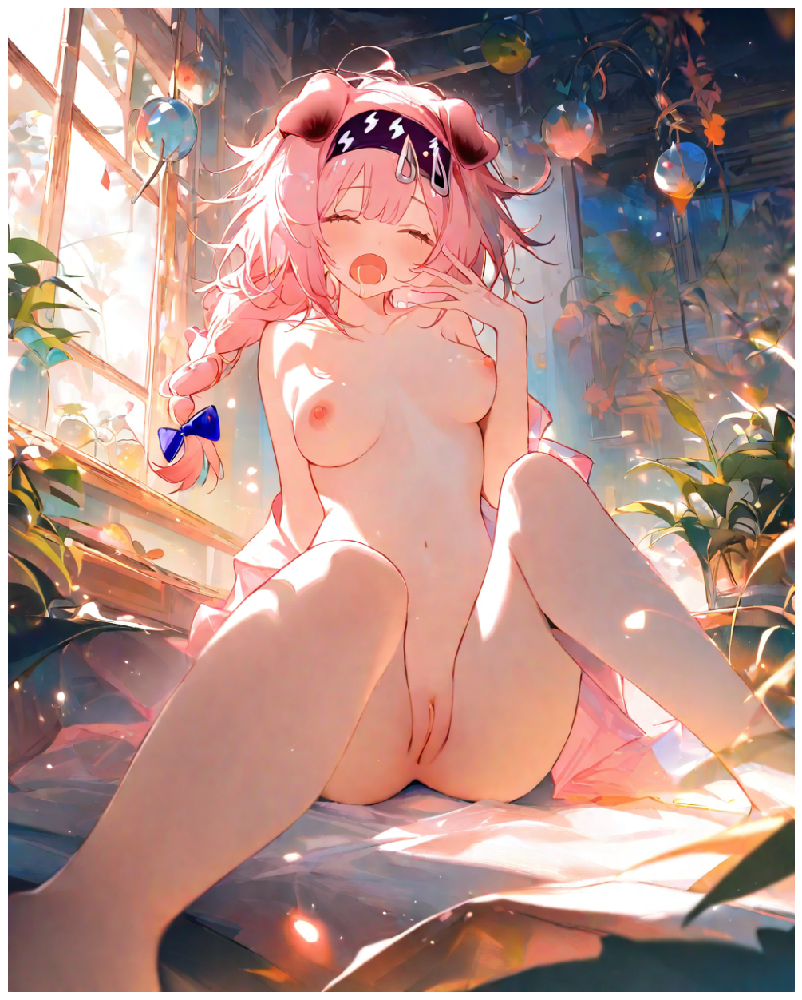

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_36_8646232_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, nipples, animal_ears, solo, pussy, pink_hair, yawning, nude, open_mouth, cat_ears, braid, hairband, completely_nude, sitting, navel, closed_eyes, bow, blue_bow, long_hair, lightning_bolt_print, hair_bow, indoors, black_hairband, medium_breasts, feet_out_of_frame, plant, uncensored, cat_girl, floppy_ears, window, collarbone, pink_jacket, knees_up, blush, on_bed, stomach, open_clothes, single_braid, potted_plant, tears, sunlight, censored, hand_up, day, spread_legs, mosaic_censoring, bed_sheet, barefoot, facing_viewer, anus, breasts_apart, tearing_up, cat_tail, hanging_plant, side_braid, bed, goldenglow_(arknights)
--------
Tags: 1girl, breasts, nipples, a

Generating Images 23:  56%|█████▌    | 14/25 [11:06<09:03, 49.40s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

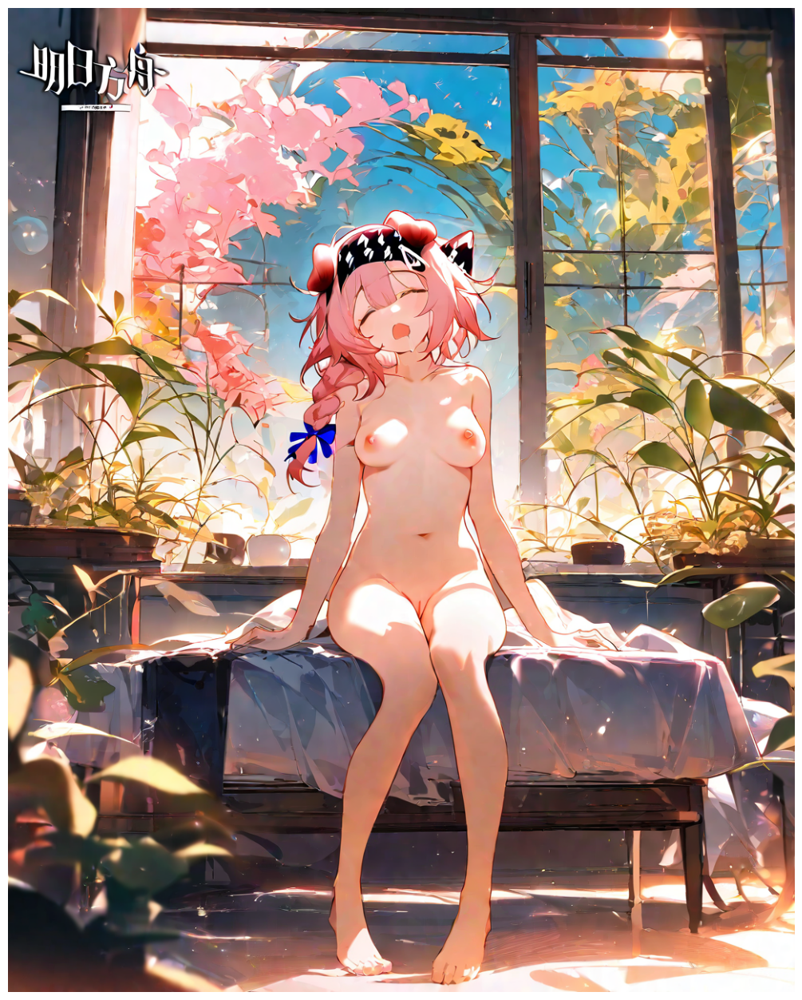

Loading model 'vit' from 'SmilingWolf/wd-vit-tagger-v3'...
Loading tag list...
Creating data transform...
Loading image and preprocessing...
Running inference...
Processing results...
Output untuk /content/outputs/goldenglow_sensitive/anime_1girl_37_7939428_sensitive.png ditambahkan ke: hasil_tag_2.txt
--------
Caption: 1girl, breasts, nude, nipples, solo, animal_ears, pink_hair, completely_nude, cat_ears, sitting, barefoot, closed_eyes, open_mouth, navel, braid, long_hair, blue_bow, bow, hair_bow, hairband, plant, pussy, indoors, full_body, window, toes, lightning_bolt_print, single_braid, potted_plant, collarbone, medium_breasts, feet, blush, cat_girl, black_hairband, day, stomach, facing_viewer, knees_together_feet_apart, small_breasts, floppy_ears, copyright_name, uncensored, bed, on_bed, legs, sunlight, blue_sky, hanging_plant, tree, toenails, cherry_blossoms, cat_tail, bed_sheet, side_braid, hair_over_shoulder, sky, breasts_apart, goldenglow_(arknights)
--------
Tags: 1girl, brea

Generating Images 23:  60%|██████    | 15/25 [11:57<08:17, 49.77s/it]

  0%|          | 0/28 [00:00<?, ?it/s]

Generating Images 23:  60%|██████    | 15/25 [12:10<08:07, 48.71s/it]


KeyboardInterrupt: 

In [6]:
w = f"/content/outputs"
if not os.path.exists(w):
    os.makedirs(w)

def generate_image(pipe, prompt, negative_prompt, output_path, width, height, guidance_scale, guidance_rescale, num_inference_steps, seed):
    """Menghasilkan gambar Stable Diffusion."""
    image = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        seed=seed,
        width=width,
        height=height,
        guidance_scale=guidance_scale,
        guidance_rescale=guidance_rescale,
        target_size=(width, height),
        original_size=(4096, 4096),
        num_inference_steps=num_inference_steps,
        truncation=True,
        # clip_skip = 2
    ).images[0]
    image.save(output_path, "png", lossless=True, quality=100)
    return image

def upscale_anime_image(input_pil, output_path):
    """Upscale gambar PIL dengan RealESRGAN anime6B dan simpan hasilnya."""
    output, _ = upscaler.enhance(input_pil)
    output.save(output_path)
    return output

def log_metadata(file_path, start_num, end_num, output_base, width, height, style, char, rating, desc_char, pov, bg, add, negative_prompt, guidance_scale, guidance_rescale, num_inference_steps, elapsed_time):
    """Mencatat metadata ke dalam file teks."""
    with open(file_path, "a") as text_file:
        text_file.write(f"\n\nTITLE: {start_num}--{end_num} {output_base} {width}x{height}px\n + {style},\n {char},\n {rating},\n {desc_char},\n {pov},\n {bg},\n {add}\n - {negative_prompt}\n guide scale/rescale: {guidance_scale}/{guidance_rescale}\n steps: {num_inference_steps}\nIt took {math.floor(elapsed_time/60)} minutes {math.floor(elapsed_time%60)} seconds!")

amount = 25 #@param {type:'integer'}
#@markdown ---
lora = "" # @param {"type":"string"}
style = "masterpiece, absurdres, amazing quality, best quality" # @param {"type":"string","placeholder":"masterpiece, high score, best quality, amazing quality, absurdres, [vibrant, very aesthetic, high contrast], masterful composition"}
char = "(1girl, goldenglow \\(arknights\\), arknights \\(series\\)), yawning, sleepy, closed eyes, mature teen, long hair, single braid, solo, completely nude, breasts, nipples, sitting, on bed, hair bow, head tilt" #@param {type:"string"}
rating = "sensitive" # @param ["safe","sensitive"] {"allow-input":true}
desc_char = "blush, medium breast, collarbone, slip, pussy, stomach, barefoot" #@param {type:'string'}
pov = "looking at viewer, from front, depth of field" # @param {"type":"string","placeholder":"dutch angle, looking at viewer, from front, depth of field, close up"}
bg = "modern, indoors, dining room, pottet plant, drooling, breast apart" # @param {"type":"string","placeholder":"colorful, indoors, natural scenery"}
add = "uncensored, light particle, natural scenery, colorful, [vibrant, very aesthetic, high detail], window" #@param {type:"string"}
if rating == "":
  ratingX="all"
#@markdown ---
prompt = f"{char}, {rating}, {lora}, {desc_char}, {pov}, {bg}, {add}, {style}"
negative_prompt = "lowres, worst quality, bad quality, bad anatomy, jpeg artifacts, unclear eyes, cropped, worst quality, low quality, low score, bad score, average score, signature, old, oldest, watermark, mosaic censoring, stripe, censored, username, chromatic aberration" #@param {type:'string'}

#@markdown ---
W = 1024 #@param {type:"slider", min:512, max:2048, step:32}
H = 1280 #@param {type:"slider", min:512, max:2048, step:32}
swapWH = False # @param {"type":"boolean"}
if swapWH:
  W, H = H, W
#@markdown ---
guidance_scale = 5 #@param {type:'number'}
guidance_rescale = 1 #@param {type:'number'}
num_inference_steps = 28 # @param {"type":"slider","min":10,"max":80,"step":1}
#@markdown ---

if len(char) > 10 or (char[:1] == "(" and char[-1:] == ")"):
    nama_char = char.split(", ")[1].split(" ")[0]
    jenis_char = char.split(", ")[0][1:]
outputname = "anime" #@param {type:'string'}
ratingX = rating.split(" ")[0]

outputbase = f"/content/outputs/{nama_char}_{ratingX}/{outputname}_{jenis_char}"
w = f"/content/outputs/{nama_char}_{ratingX}"
if not os.path.exists(w):
    os.makedirs(w)
rand = True #@param {type:'boolean'}
if rand:
    seed = 9999999 #@param {type:'integer'}
startNum = num

taggers = True #@param {type:'boolean'}

start_time = time.time()
array_time = []

for x in tqdm(range(amount), desc=f"Generating Images {num}"):
    gc.collect()
    torch.cuda.empty_cache()
    image_start_time = time.time()
    if rand:
        set_seed = random.randint(10, 10000000)
    else:
        set_seed = seed
    output_file = f"{outputbase}_{num}_{set_seed}_{ratingX}.png"
    image = generate_image(pipe, prompt, negative_prompt, output_file, W, H, guidance_scale, guidance_rescale, num_inference_steps, set_seed)
    blurred_image = image.filter(ImageFilter.GaussianBlur(radius=0))
    plt.figure(figsize=(W/80, H/80))
    if "nsfw" in rating or "explicit" in rating:
      plt.imshow(blurred_image)
    else :
      plt.imshow(image)
    plt.axis('off')
    plt.show()
    image_end_time = time.time()
    array_time.append(image_end_time - image_start_time)
    num += 1
    if taggers:
      !python /content/wd14-tagger.py "{output_file}" --output_file "hasil_tag_{prompt_num}.txt"

end_time = time.time()
total_time = end_time - start_time
log_metadata(f"prompt_{prompt_num}.txt", startNum, num - 1, outputbase, W, H, style, char, rating, desc_char, pov, bg, add, negative_prompt, guidance_scale, guidance_rescale, num_inference_steps, total_time)

gc.collect()
torch.cuda.empty_cache()

print(f"It took {math.floor(total_time/60)} minutes {math.floor(total_time%60)} seconds!")



In [2]:
#@title +load_lora
from google.colab import drive
import datetime
drive.mount('/content/drive')

lora_path = "/content/drive/MyDrive/Colab Notebooks/parsley-XL-v31-ep20.safetensors" #@param {type:"string"}
print(f"Memasang LoRA dari: {lora_path}")
pipe.load_lora_weights(lora_path)

Mounted at /content/drive
Memasang LoRA dari: /content/drive/MyDrive/Colab Notebooks/parsley-XL-v31-ep20.safetensors


In [24]:
#@title +unload_lora

print("Melepas LoRA")
pipe.unload_lora_weights()

Melepas LoRA


In [ ]:
#@title ##**Tagger**
#!git clone https://github.com/neggles/wdv3-timm.git
#!pip install -q -r "/content/wdv3-timm/requirements.txt"
!curl -o wd14-tagger.py https://raw.githubusercontent.com/FreNzQuiN/GenerativeAI/refs/heads/main/Stable_Diffusion/wd14-tagger.py


In [ ]:
# Run
# <swinv2|convnext|vit>
path = "/content/outputs/goldenglow_sensitive/anime_1girl_14_793090893_sensitive safe.png" # @param [] {"allow-input":true}
#!python /content/wdv3-timm/wdv3_timm.py <swinv2|convnext|vit> {path}
!python /content/wd14-tagger.py "{path}"

Traceback (most recent call last):
  File "/content/wd14-tagger.py", line 203, in <module>
    main(opts)
  File "/content/wd14-tagger.py", line 126, in main
    raise FileNotFoundError(f"Image file not found: {image_path}")
FileNotFoundError: Image file not found: /content/outputs/goldenglow_sensitive/anime_1girl_14_793090893_sensitive


In [ ]:
#@title ##**2.2 PLAY IMG2IMG**
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows * cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols * w, rows * h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

def download_image(url):
    response = requests.get(url)
    return Image.open(BytesIO(response.content)).convert("RGB")

def img2img_generation(image, prompt, negative_prompt, num_inference_steps=25, guidance_scale=7.5, strength=0.7):
    images = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        image=image,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        strength=strength,
    ).images
    return images

# Contoh Penggunaan img2img
image_url = "https://huggingface.co/datasets/hf-internal-testing/diffusers-images/resolve/main/sd_xl/input_1024x1024.png"
init_image = download_image(image_url)

prompt = "A futuristic city skyline, neon lights, cyberpunk style"
negative_prompt = "blurry, low quality, deformed"

generated_images = img2img_generation(
    image=init_image,
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=25,
    guidance_scale=7.5,
    strength=0.7
)

grid = image_grid(generated_images, rows=1, cols=1)
plt.imshow(grid)
plt.axis('off')
plt.show()

In [ ]:
#@title ## **PLAY IMG2TEXT**
from transformers import BlipProcessor, BlipForConditionalGeneration

processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base").to("cuda")

img_url = 'https://storage.googleapis.com/sfr-vision-language-research/BLIP/demo.jpg' #@param {type:"string"}
raw_image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')

# conditional image captioning
# text = "a photography of"
# inputs = processor(raw_image, text, return_tensors="pt").to("cuda")

# out = model.generate(**inputs)
# print(processor.decode(out[0], skip_special_tokens=True))
# # >>> a photography of a woman and her dog

# unconditional image captioning
inputs = processor(raw_image, return_tensors="pt").to("cuda")

out = model.generate(**inputs)
print(processor.decode(out[0], skip_special_tokens=True))

In [ ]:
#@title # +**remove_file(s)**
!rm "/content/"*.png
prompt_num=prompt_num+1

In [ ]:
!rm f"/content/{outputbase}{num-1}_{setseed}.png"

In [7]:
#@title #**3.0 CONNECT & SAVE TO GOOGLE DRIVE**
from google.colab import drive
import datetime

drive.mount('/content/drive')

x = datetime.datetime.now().strftime("%Y_%m_%d")
!mkdir "/content/drive/MyDrive/Colab Notebooks/{x}"
!mkdir "/content/drive/MyDrive/Colab Notebooks/{x}/prompt{prompt_num}"

!mv "/content/outputs/" "/content/drive/MyDrive/Colab Notebooks/{x}/prompt{prompt_num}"
!mv "/content/"*.txt "/content/drive/MyDrive/Colab Notebooks/{x}/prompt{prompt_num}"

prompt_num = prompt_num + 1

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
mkdir: cannot create directory ‘/content/drive/MyDrive/Colab Notebooks/2025_05_10’: File exists


In [ ]:
!mv /content/dir {dir}

In [ ]:
!mkdir outputs

In [ ]:
!mv "/content/"*.png "/content/outputs"

In [ ]:
!smi-nvidia

In [ ]:
#@title #**4.0 AUTOMATE PROMPTING (COMINGSOON)**

class PromptStableDiffusion:
    def __init__(self, subjek, gaya, latar_belakang, detail_tambahan):
        self.subjek = subjek
        self.gaya = gaya
        self.latar_belakang = latar_belakang
        self.detail_tambahan = detail_tambahan

    def buat_prompt(self):
        prompt = f"{self.subjek}, {self.gaya}, latar belakang {self.latar_belakang}, {self.detail_tambahan}"
        return prompt

prompt1 = PromptStableDiffusion(
    subjek="seorang wanita muda",
    gaya="lukisan cat minyak impresionis",
    latar_belakang="taman bunga matahari yang luas",
    detail_tambahan="matahari terbenam, burung-burung terbang di kejauhan"
)

prompt2 = PromptStableDiffusion(
    subjek="seekor naga raksasa",
    gaya="fantasi gelap",
    latar_belakang="kastil kuno yang hancur",
    detail_tambahan="langit mendung, petir menyambar"
)

daftar_prompt = [prompt1, prompt2]

for prompt_obj in daftar_prompt:
    print(prompt_obj.buat_prompt())



import json
daftar_prompt_json = [prompt_obj.__dict__ for prompt_obj in daftar_prompt]

with open("prompt_stable_diffusion.json", "w") as f:
    json.dump(daftar_prompt_json, f, indent=4)

print("\nPrompt telah disimpan dalam file prompt_stable_diffusion.json")

In [ ]:
!export PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True

In [14]:
import os
os.environ['PYTORCH_CUDA_ALLOC_CONF'] = 'expandable_segments:True'

# **0.0 *~ ARCHIVE*** ~

In [ ]:
!pip install numba
from numba import cuda
device = cuda.get_current_device()
device.reset()

In [ ]:
#@markdown # Read Glosarium
!git clone https://github.com/FreNzQuiN/GenerativeAI/blob/main/Stable_Diffusion/cheatsheet.md

In [ ]:
!pip show diffusers

In [ ]:
#@title # **2.1** *ARCHIVED*
from compel import Compel, ReturnedEmbeddingsType
import matplotlib.pyplot as plt
from PIL import Image
import random, time, math, os
import torch, gc
from tqdm import tqdm


w = f"/content/outputs"
if not os.path.exists(w):
  !mkdir {w}

def generate_image(pipe, prompt, negative_prompt, output_path, width, height, guidance_scale, guidance_rescale, num_inference_steps, seed):
    """Menghasilkan gambar Stable Diffusion."""
    image = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        seed=seed,
        width=width,
        height=height,
        guidance_scale=guidance_scale,
        guidance_rescale=guidance_rescale,
        target_size=(width, height),
        original_size=(4096, 4096),
        num_inference_steps=num_inference_steps,
        truncation=True
    ).images[0]
    image.save(output_path)
    return image

def log_metadata(file_path, start_num, end_num, output_base, width, height, prompt, negative_prompt, guidance_scale, guidance_rescale, num_inference_steps, elapsed_time):
    """Mencatat metadata ke dalam file teks."""
    with open(file_path, "a") as text_file:
        text_file.write(f"\n\nTITLE: {start_num}--{end_num} {output_base} {width}x{height}px\n + {prompt}\n - {negative_prompt}\n guide scale/rescale: {guidance_scale}/{guidance_rescale}\n steps: {num_inference_steps}\nIt took {math.floor(elapsed_time/60)} minutes {math.floor(elapsed_time%60)} seconds!")


amount = 50 #@param {type:'integer'}
#@markdown ---
char = "(1girl, goldenglow \\(arknights)\\, arknights \\(series)\\)" #@param {type:"string"}
desc_char = "close up, smirk, seducing expression, light blush, her outfit, mature teen, glow eyes, medium breast" #@param {type:'string'}
pov = "looking at viewer, from front, depth of field" # @param {"type":"string","placeholder":"dutch angle, looking at viewer, from front, depth of field, close up"}
bg = " colorful, indoors, room, natural scenery" # @param {"type":"string","placeholder":"colorful, indoors, natural scenery"}
style = "masterpiece, high score, best quality, amazing quality, absurdres" #@param {type:"string"}
add = "[light particles]" #@param {type:"string"}
rating = "safe sensitive" # @param ["safe","sensitive"] {"allow-input":true}
#@markdown ---
prompt = f"{style}, {char}, {rating}, {desc_char}, {pov}, {bg}, {add}"
negative_prompt = " text,watermark,bad anatomy,bad proportions,extra limbs,extra digit,extra legs,extra legs and arms,disfigured,missing arms,too many fingers,fused fingers,missing fingers,unclear eyes,watermark,username" #@param {type:'string'}
#@markdown ---
W = 960 #@param {type:"slider", min:512, max:2048, step:32}
H = 1312 #@param {type:"slider", min:512, max:2048, step:32}
guidance_scale = 5 #@param {type:'number'}
guidance_rescale = 0.9 #@param {type:'number'}
num_inference_steps = 32 #@param {type:"slider", min:10, max:40, step:1}
#@markdown ---

if len(char)>10 or (char[:1]=="(" and char[-1:]==")"):
  nama_char = char.split(", ")[1].split(" ")[0]
  jenis_char = char.split(", ")[0][1:]
outputname = "anime" #@param {type:'string'}
ratingX = rating.split(" ")[0]

outputbase = f"/content/outputs/{nama_char}_{ratingX}/{outputname}_{jenis_char}"
w = f"/content/outputs/{nama_char}_{ratingX}"
if not os.path.exists(w):
  !mkdir {w}
rand = True #@param {type:'boolean'}
if rand:
  seed = 9999999 #@param {type:'integer'}
startNum = num

start_time = time.time()
array_time = []

for x in tqdm(range(amount), desc=f"Generating Images {num}"):
    gc.collect()
    torch.cuda.empty_cache()
    image_start_time = time.time()
    if rand:
        set_seed = random.randint(100000, 100000000)
    else:
        set_seed = seed
    output_file = f"{outputbase}_{num}_{set_seed}_{rating}.png"
    image = generate_image(pipe, prompt, negative_prompt, output_file, W, H, guidance_scale, guidance_rescale, num_inference_steps, set_seed)
    plt.imshow(image)
    image_end_time = time.time()
    array_time.append(image_end_time - image_start_time)
    num += 1

end_time = time.time()
total_time = end_time - start_time
log_metadata(f"prompt{prompt_num}.txt", startNum, num - 1, outputbase, W, H, prompt, negative_prompt, guidance_scale, guidance_rescale, num_inference_steps, total_time)

gc.collect()
torch.cuda.empty_cache()

print(f"It took {math.floor(total_time/60)} minutes {math.floor(total_time%60)} seconds!")

In [ ]:
#@title #**2.1 PLAY TEXT2IMG SD** *ARCHIVED*
from compel import Compel, ReturnedEmbeddingsType
import matplotlib.pyplot as plt
from PIL import Image
import random
import time
import math
import torch, gc

textFile = open(f"prompt{prompt_num}.txt", "a")

amount = 5 #@param {type:'integer'}
prompt = "1girl, goldenglow \(arknights\), arknights \(series\), dutch angle, looking at viewer, cgdct, cute, solo, smile, light particles, casual, beautiful background, blush, outdoors, park, medium breast, from front, depth of field, very smooth line, year 2024, masterpiece, high score, great score, absurdres" #@param {type:'string'}
negative_prompt = "lowres, bad anatomy, bad hands, text, error, missing finger, extra digits, fewer digits, cropped, worst quality, low quality, low score, bad score, average score, signature, watermark, username, blurry" #@param {type:'string'}
outputbase = "/content/anime_girl" #@param {type:'string'}
startNum = num

# compel = Compel(
#   tokenizer=[pipe.tokenizer, pipe.tokenizer_2] ,
#   text_encoder=[pipe.text_encoder, pipe.text_encoder_2],
#   returned_embeddings_type=ReturnedEmbeddingsType.PENULTIMATE_HIDDEN_STATES_NON_NORMALIZED,
#   requires_pooled=[False, True]
# )
# conditioning, pooled = compel(prompt)
W = 1024 #@param {type:'integer'}
H = 1424 #@param {type:'integer'}
guidance_scale = 5 #@param {type:'number'}
guidance_rescale = 0.9 #@param {type:'number'}
num_inference_steps = 28 #@param {type:'integer'}
rand = True #@param {type:'boolean'}
start = time.time()
arrayTime = []

for x in range(amount):
  gc.collect()
  torch.cuda.empty_cache()
  start = time.time()
  if rand == True:
    setseed = random.randint(100000,10000000)
  else:
    seed = 6 #@param {type:'integer'}
    setseed = seed
  image = pipe(
      # prompt_embeds=conditioning, pooled_prompt_embeds=pooled,
      prompt=prompt,
      negative_prompt=negative_prompt,
      seed=setseed,
      width=W,
      height=H,
      guidance_scale=guidance_scale,
      guidance_rescale=guidance_rescale,
      target_size=(W,H),
      original_size=(4096,4096),
      num_inference_steps=num_inference_steps,
      truncation=True
      ).images[0]
  output=f"{outputbase}{num}_{setseed}.png"
  image.save(output)
  image = Image.open(output)
  plt.imshow(image)
  end = time.time()
  length = end - start
  arrayTime.append(length)
  num=num+1

end = time.time()
length = end - start
print("It took", math.floor(length/60), "minutes", math.floor(length%60), "seconds!")
textFile.write(f"\n\nTITLE: {startNum}--{num-1} {outputbase} {W}x{H}px\n + {prompt}\n - {negative_prompt}\n guide scale/rescale: {guidance_scale}/{guidance_rescale}\n steps: {num_inference_steps}\nIt took {math.floor(length/60)} minutes {math.floor(length%60)} seconds!")
textFile.close()
gc.collect()
torch.cuda.empty_cache()